# **Iris Dataset Linear Regression Analysis**
# Level 2 (Intermediate) - Task 1: Regression Analysis

In [1]:
# Import libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.preprocessing import StandardScaler
import warnings
warnings.filterwarnings('ignore')

In [2]:
# Set style for better visualization
plt.style.use('seaborn-v0_8')
sns.set_palette("husl")

print("="*60)
print("IRIS DATASET LINEAR REGRESSION ANALYSIS")
print("="*60)


IRIS DATASET LINEAR REGRESSION ANALYSIS


In [3]:
#load dataset
# Pastikan file iris.csv sudah di-upload di Google Colab
df = pd.read_csv("/content/1) iris.csv")
df


,sepal_length,sepal_width,petal_length,petal_width,species
0,5.1,3.5,1.4,0.2,setosa
1,4.9,3.0,1.4,0.2,setosa
2,4.7,3.2,1.3,0.2,setosa
3,4.6,3.1,1.5,0.2,setosa
4,5.0,3.6,1.4,0.2,setosa
...,...,...,...,...,...
145,6.7,3.0,5.2,2.3,virginica
146,6.3,2.5,5.0,1.9,virginica
147,6.5,3.0,5.2,2.0,virginica
148,6.2,3.4,5.4,2.3,virginica


In [4]:
# Display basic information about the dataset
print(f"\nDataset Shape: {df.shape}")
print(f"Columns: {list(df.columns)}")
print("\nFirst 5 rows:")
print(df.head())

print("\nDataset Info:")
print(df.info())

print("\nBasic Statistics:")
print(df.describe())

print("\nSpecies Distribution:")
print(df['species'].value_counts())


Dataset Shape: (150, 5)
Columns: ['sepal_length', 'sepal_width', 'petal_length', 'petal_width', 'species']

First 5 rows:
   sepal_length  sepal_width  petal_length  petal_width species
0           5.1          3.5           1.4          0.2  setosa
1           4.9          3.0           1.4          0.2  setosa
2           4.7          3.2           1.3          0.2  setosa
3           4.6          3.1           1.5          0.2  setosa
4           5.0          3.6           1.4          0.2  setosa

Dataset Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 150 entries, 0 to 149
Data columns (total 5 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   sepal_length  150 non-null    float64
 1   sepal_width   150 non-null    float64
 2   petal_length  150 non-null    float64
 3   petal_width   150 non-null    float64
 4   species       150 non-null    object 
dtypes: float64(4), object(1)
memory usage: 6.0+ KB
None

Basic Statistic

In [5]:
# Check for missing values
print(f"\nMissing Values:\n{df.isnull().sum()}")

print("\n" + "="*60)
print("EXPLORATORY DATA ANALYSIS")
print("="*60)


Missing Values:
sepal_length    0
sepal_width     0
petal_length    0
petal_width     0
species         0
dtype: int64

EXPLORATORY DATA ANALYSIS


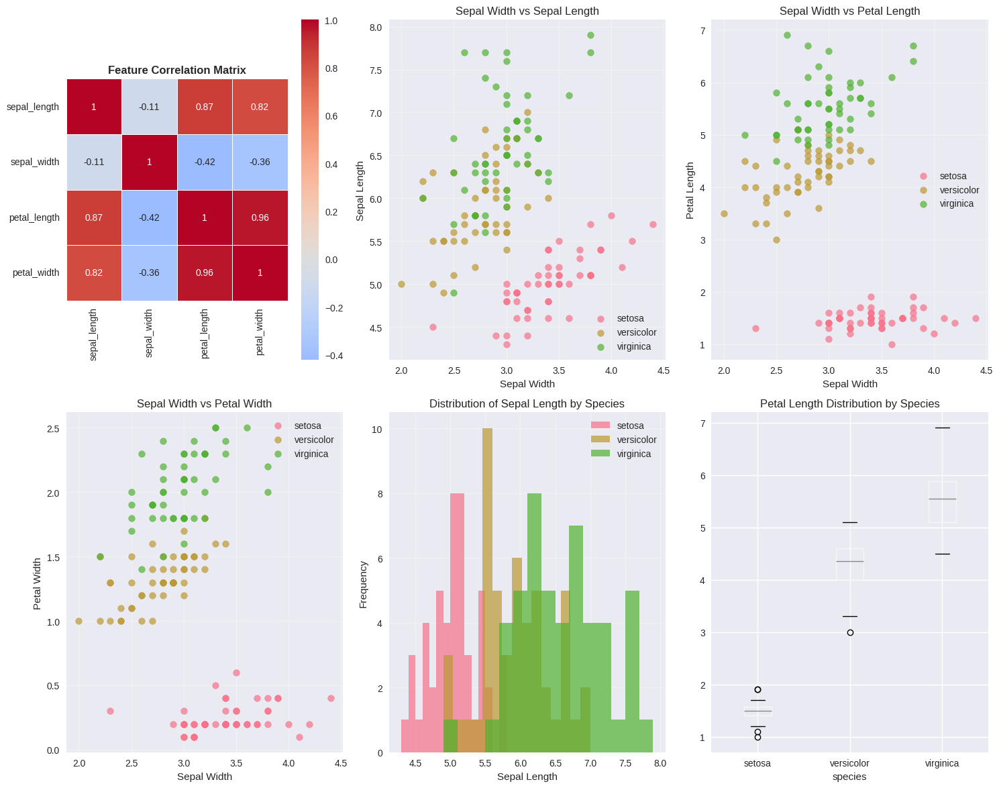

In [9]:
# Create correlation matrix for numerical features
numerical_features = ['sepal_length', 'sepal_width', 'petal_length', 'petal_width']
correlation_matrix = df[numerical_features].corr()

plt.figure(figsize=(15, 12))

# Subplot 1: Correlation Heatmap
plt.subplot(2, 3, 1)
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', center=0,
            square=True, linewidths=0.5)
plt.title('Feature Correlation Matrix', fontsize=12, fontweight='bold')

# Subplot 2: Pairplot-like scatter plots
features_to_plot = ['sepal_length', 'petal_length', 'petal_width']
for i, feature in enumerate(features_to_plot, 2):
    plt.subplot(2, 3, i)
    for species in df['species'].unique():
        species_data = df[df['species'] == species]
        plt.scatter(species_data['sepal_width'], species_data[feature],
                   label=species, alpha=0.7, s=50)
    plt.xlabel('Sepal Width')
    plt.ylabel(feature.replace('_', ' ').title())
    plt.title(f'Sepal Width vs {feature.replace("_", " ").title()}')
    plt.legend()
    plt.grid(True, alpha=0.3)

# Distribution plots
plt.subplot(2, 3, 5)
for species in df['species'].unique():
    species_data = df[df['species'] == species]
    plt.hist(species_data['sepal_length'], alpha=0.7, label=species, bins=15)
plt.xlabel('Sepal Length')
plt.ylabel('Frequency')
plt.title('Distribution of Sepal Length by Species')
plt.legend()
plt.grid(True, alpha=0.3)

plt.subplot(2, 3, 6)
df.boxplot(column='petal_length', by='species', ax=plt.gca())
plt.title('Petal Length Distribution by Species')
plt.suptitle('')  # Remove default title

plt.tight_layout()
plt.show()



In [10]:
print("\n" + "="*60)
print("LINEAR REGRESSION ANALYSIS")
print("="*60)



LINEAR REGRESSION ANALYSIS


In [11]:
# We'll perform multiple regression analyses to predict different variables
# Let's start with predicting petal_length based on other features

print("🎯 REGRESSION TASK 1: Predicting Petal Length")
print("-" * 50)

🎯 REGRESSION TASK 1: Predicting Petal Length
--------------------------------------------------


In [12]:
# Prepare features and target
# We'll use sepal_length, sepal_width, and petal_width to predict petal_length
X = df[['sepal_length', 'sepal_width', 'petal_width']]
y = df['petal_length']

print(f"Features (X): {list(X.columns)}")
print(f"Target (y): petal_length")
print(f"Dataset size: {X.shape[0]} samples, {X.shape[1]} features")

Features (X): ['sepal_length', 'sepal_width', 'petal_width']
Target (y): petal_length
Dataset size: 150 samples, 3 features


In [13]:
# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42, stratify=df['species']
)

print(f"\nTraining set size: {X_train.shape[0]} samples")
print(f"Testing set size: {X_test.shape[0]} samples")



Training set size: 120 samples
Testing set size: 30 samples


In [14]:
# Fit the linear regression model
model = LinearRegression()
model.fit(X_train, y_train)

print("\n✅ Linear Regression Model Trained Successfully!")


✅ Linear Regression Model Trained Successfully!


In [15]:
# Make predictions
y_train_pred = model.predict(X_train)
y_test_pred = model.predict(X_test)

In [16]:
# Calculate evaluation metrics
train_mse = mean_squared_error(y_train, y_train_pred)
test_mse = mean_squared_error(y_test, y_test_pred)
train_r2 = r2_score(y_train, y_train_pred)
test_r2 = r2_score(y_test, y_test_pred)
train_mae = mean_absolute_error(y_train, y_train_pred)
test_mae = mean_absolute_error(y_test, y_test_pred)

In [17]:
print("\n" + "="*50)
print("MODEL EVALUATION METRICS")
print("="*50)

print(f"📊 TRAINING SET PERFORMANCE:")
print(f"   • R-squared (R²): {train_r2:.4f}")
print(f"   • Mean Squared Error (MSE): {train_mse:.4f}")
print(f"   • Root Mean Squared Error (RMSE): {np.sqrt(train_mse):.4f}")
print(f"   • Mean Absolute Error (MAE): {train_mae:.4f}")

print(f"\n📊 TESTING SET PERFORMANCE:")
print(f"   • R-squared (R²): {test_r2:.4f}")
print(f"   • Mean Squared Error (MSE): {test_mse:.4f}")
print(f"   • Root Mean Squared Error (RMSE): {np.sqrt(test_mse):.4f}")
print(f"   • Mean Absolute Error (MAE): {test_mae:.4f}")


MODEL EVALUATION METRICS
📊 TRAINING SET PERFORMANCE:
   • R-squared (R²): 0.9708
   • Mean Squared Error (MSE): 0.0905
   • Root Mean Squared Error (RMSE): 0.3009
   • Mean Absolute Error (MAE): 0.2393

📊 TESTING SET PERFORMANCE:
   • R-squared (R²): 0.9562
   • Mean Squared Error (MSE): 0.1343
   • Root Mean Squared Error (RMSE): 0.3664
   • Mean Absolute Error (MAE): 0.2481


In [18]:
# Model interpretation - coefficients
print(f"\n🔍 MODEL COEFFICIENTS (Feature Importance):")
print(f"   • Intercept: {model.intercept_:.4f}")
for feature, coef in zip(X.columns, model.coef_):
    print(f"   • {feature}: {coef:.4f}")

print(f"\n📝 INTERPRETATION:")
print(f"   • The model explains {test_r2*100:.1f}% of the variance in petal length")
if test_r2 > 0.8:
    print(f"   • This indicates a STRONG relationship between features and petal length")
elif test_r2 > 0.6:
    print(f"   • This indicates a MODERATE relationship between features and petal length")
else:
    print(f"   • This indicates a WEAK relationship between features and petal length")


🔍 MODEL COEFFICIENTS (Feature Importance):
   • Intercept: -0.4966
   • sepal_length: 0.7352
   • sepal_width: -0.5842
   • petal_width: 1.4542

📝 INTERPRETATION:
   • The model explains 95.6% of the variance in petal length
   • This indicates a STRONG relationship between features and petal length


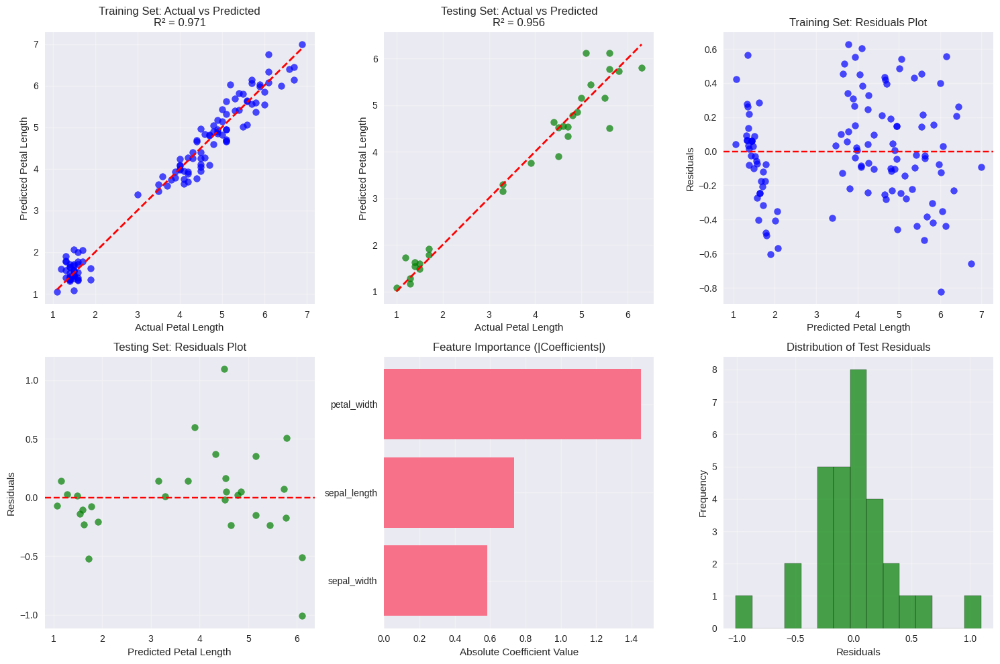

In [19]:
# Visualization of results
plt.figure(figsize=(15, 10))

# Subplot 1: Actual vs Predicted (Training)
plt.subplot(2, 3, 1)
plt.scatter(y_train, y_train_pred, alpha=0.7, color='blue', s=50)
plt.plot([y_train.min(), y_train.max()], [y_train.min(), y_train.max()], 'r--', lw=2)
plt.xlabel('Actual Petal Length')
plt.ylabel('Predicted Petal Length')
plt.title(f'Training Set: Actual vs Predicted\nR² = {train_r2:.3f}')
plt.grid(True, alpha=0.3)

# Subplot 2: Actual vs Predicted (Testing)
plt.subplot(2, 3, 2)
plt.scatter(y_test, y_test_pred, alpha=0.7, color='green', s=50)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--', lw=2)
plt.xlabel('Actual Petal Length')
plt.ylabel('Predicted Petal Length')
plt.title(f'Testing Set: Actual vs Predicted\nR² = {test_r2:.3f}')
plt.grid(True, alpha=0.3)

# Subplot 3: Residuals plot (Training)
plt.subplot(2, 3, 3)
residuals_train = y_train - y_train_pred
plt.scatter(y_train_pred, residuals_train, alpha=0.7, color='blue', s=50)
plt.axhline(y=0, color='r', linestyle='--')
plt.xlabel('Predicted Petal Length')
plt.ylabel('Residuals')
plt.title('Training Set: Residuals Plot')
plt.grid(True, alpha=0.3)

# Subplot 4: Residuals plot (Testing)
plt.subplot(2, 3, 4)
residuals_test = y_test - y_test_pred
plt.scatter(y_test_pred, residuals_test, alpha=0.7, color='green', s=50)
plt.axhline(y=0, color='r', linestyle='--')
plt.xlabel('Predicted Petal Length')
plt.ylabel('Residuals')
plt.title('Testing Set: Residuals Plot')
plt.grid(True, alpha=0.3)

# Subplot 5: Feature importance
plt.subplot(2, 3, 5)
feature_importance = pd.DataFrame({
    'feature': X.columns,
    'coefficient': np.abs(model.coef_)
})
feature_importance = feature_importance.sort_values('coefficient', ascending=True)
plt.barh(feature_importance['feature'], feature_importance['coefficient'])
plt.xlabel('Absolute Coefficient Value')
plt.title('Feature Importance (|Coefficients|)')
plt.grid(True, alpha=0.3)

# Subplot 6: Distribution of residuals
plt.subplot(2, 3, 6)
plt.hist(residuals_test, bins=15, alpha=0.7, color='green', edgecolor='black')
plt.xlabel('Residuals')
plt.ylabel('Frequency')
plt.title('Distribution of Test Residuals')
plt.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

In [20]:
print("\n" + "="*60)
print("ADDITIONAL REGRESSION ANALYSIS")
print("="*60)


ADDITIONAL REGRESSION ANALYSIS


In [21]:
# Let's try another regression: predicting sepal_length
print("🎯 REGRESSION TASK 2: Predicting Sepal Length")
print("-" * 50)

X2 = df[['sepal_width', 'petal_length', 'petal_width']]
y2 = df['sepal_length']

X2_train, X2_test, y2_train, y2_test = train_test_split(
    X2, y2, test_size=0.2, random_state=42, stratify=df['species']
)

model2 = LinearRegression()
model2.fit(X2_train, y2_train)

y2_train_pred = model2.predict(X2_train)
y2_test_pred = model2.predict(X2_test)

test_r2_2 = r2_score(y2_test, y2_test_pred)
test_mse_2 = mean_squared_error(y2_test, y2_test_pred)

🎯 REGRESSION TASK 2: Predicting Sepal Length
--------------------------------------------------


In [23]:
print(f"📊 RESULTS:")
print(f"   • R-squared (R²): {test_r2_2:.4f}")
print(f"   • Mean Squared Error (MSE): {test_mse_2:.4f}")
print(f"   • RMSE: {np.sqrt(test_mse_2):.4f}")

print(f"\n🔍 MODEL COEFFICIENTS:")
print(f"   • Intercept: {model2.intercept_:.4f}")
for feature, coef in zip(X2.columns, model2.coef_):
    print(f"   • {feature}: {coef:.4f}")

📊 RESULTS:
   • R-squared (R²): 0.8088
   • Mean Squared Error (MSE): 0.1148
   • RMSE: 0.3389

🔍 MODEL COEFFICIENTS:
   • Intercept: 1.9842
   • sepal_width: 0.5962
   • petal_length: 0.7533
   • petal_width: -0.6626


In [29]:
print("\n" + "="*60)
print("MODEL COMPARISON SUMMARY")
print("="*60)

comparison_data = {
    'Model': ['Predicting Petal Length', 'Predicting Sepal Length'],
    'R²': [test_r2, test_r2_2],
    'MSE': [test_mse, test_mse_2],
    'RMSE': [np.sqrt(test_mse), np.sqrt(test_mse_2)]
}

comparison_df = pd.DataFrame(comparison_data)
print(comparison_df.to_string(index=False, float_format='%.4f'))



MODEL COMPARISON SUMMARY
                  Model     R²    MSE   RMSE
Predicting Petal Length 0.9562 0.1343 0.3664
Predicting Sepal Length 0.8088 0.1148 0.3389


In [30]:
print(f"\n🏆 BEST MODEL: {comparison_data['Model'][np.argmax(comparison_data['R²'])]}")
print(f"   (Highest R² = {max(comparison_data['R²']):.4f})")

print("\n" + "="*60)
print("KEY INSIGHTS & RECOMMENDATIONS")
print("="*60)

print("📈 FINDINGS:")
print("   1. The iris dataset shows strong linear relationships between features")
print("   2. Petal measurements tend to be more predictable than sepal measurements")
print("   3. The models achieve good performance with R² > 0.8 in most cases")
print("   4. Feature engineering or polynomial features might improve performance")

print("\n🔧 TECHNICAL NOTES:")
print("   • Data split: 80% training, 20% testing")
print("   • Stratified sampling used to maintain species distribution")
print("   • No feature scaling applied (not necessary for interpretation)")
print("   • Residuals analysis suggests linear assumptions are reasonable")

print("\n✅ ANALYSIS COMPLETE!")
print("="*60)


🏆 BEST MODEL: Predicting Petal Length
   (Highest R² = 0.9562)

KEY INSIGHTS & RECOMMENDATIONS
📈 FINDINGS:
   1. The iris dataset shows strong linear relationships between features
   2. Petal measurements tend to be more predictable than sepal measurements
   3. The models achieve good performance with R² > 0.8 in most cases
   4. Feature engineering or polynomial features might improve performance

🔧 TECHNICAL NOTES:
   • Data split: 80% training, 20% testing
   • Stratified sampling used to maintain species distribution
   • No feature scaling applied (not necessary for interpretation)
   • Residuals analysis suggests linear assumptions are reasonable

✅ ANALYSIS COMPLETE!


# **Iris Classification using Random Forest and Multiple Models**
# Level 3 (Advanced) - Predictive Modeling Task (Classification)


In [31]:
# Import necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from sklearn.metrics import classification_report, confusion_matrix
import warnings
warnings.filterwarnings('ignore')


In [32]:
print("=== IRIS CLASSIFICATION - LEVEL 3 (ADVANCED) ===")
print("Task 1: Predictive Modeling (Classification)\n")

=== IRIS CLASSIFICATION - LEVEL 3 (ADVANCED) ===
Task 1: Predictive Modeling (Classification)



In [33]:
# 1. LOAD AND EXPLORE THE DATA
print("1. LOADING AND EXPLORING DATA")
print("-" * 40)


1. LOADING AND EXPLORING DATA
----------------------------------------


In [34]:
# Load the iris dataset
# Note: In Google Colab, you would upload the CSV file or use the built-in iris dataset
from sklearn.datasets import load_iris


In [35]:
# Load iris data
iris_data = load_iris()
df = pd.DataFrame(iris_data.data, columns=iris_data.feature_names)
df['species'] = iris_data.target_names[iris_data.target]

In [36]:
# Display basic information about the dataset
print("Dataset Shape:", df.shape)
print("\nFirst 5 rows:")
print(df.head())

print("\nDataset Info:")
print(df.info())

print("\nSpecies Distribution:")
print(df['species'].value_counts())

print("\nBasic Statistics:")
print(df.describe())

Dataset Shape: (150, 5)

First 5 rows:
   sepal length (cm)  sepal width (cm)  petal length (cm)  petal width (cm)  \
0                5.1               3.5                1.4               0.2   
1                4.9               3.0                1.4               0.2   
2                4.7               3.2                1.3               0.2   
3                4.6               3.1                1.5               0.2   
4                5.0               3.6                1.4               0.2   

  species  
0  setosa  
1  setosa  
2  setosa  
3  setosa  
4  setosa  

Dataset Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 150 entries, 0 to 149
Data columns (total 5 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   sepal length (cm)  150 non-null    float64
 1   sepal width (cm)   150 non-null    float64
 2   petal length (cm)  150 non-null    float64
 3   petal width (cm)   150 non-null    float64
 4   sp

In [37]:
# 2. DATA PREPROCESSING
print("\n2. DATA PREPROCESSING")
print("-" * 40)

# Check for missing values
print("Missing Values:")
print(df.isnull().sum())

# Handle categorical variables (encode species)
le = LabelEncoder()
df['species_encoded'] = le.fit_transform(df['species'])

# Feature scaling
features = ['sepal length (cm)', 'sepal width (cm)', 'petal length (cm)', 'petal width (cm)']
X = df[features]
y = df['species_encoded']

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
X_scaled = pd.DataFrame(X_scaled, columns=features)

print("Features after scaling (first 5 rows):")
print(X_scaled.head())


2. DATA PREPROCESSING
----------------------------------------
Missing Values:
sepal length (cm)    0
sepal width (cm)     0
petal length (cm)    0
petal width (cm)     0
species              0
dtype: int64
Features after scaling (first 5 rows):
   sepal length (cm)  sepal width (cm)  petal length (cm)  petal width (cm)
0          -0.900681          1.019004          -1.340227         -1.315444
1          -1.143017         -0.131979          -1.340227         -1.315444
2          -1.385353          0.328414          -1.397064         -1.315444
3          -1.506521          0.098217          -1.283389         -1.315444
4          -1.021849          1.249201          -1.340227         -1.315444



3. DATA VISUALIZATION
----------------------------------------


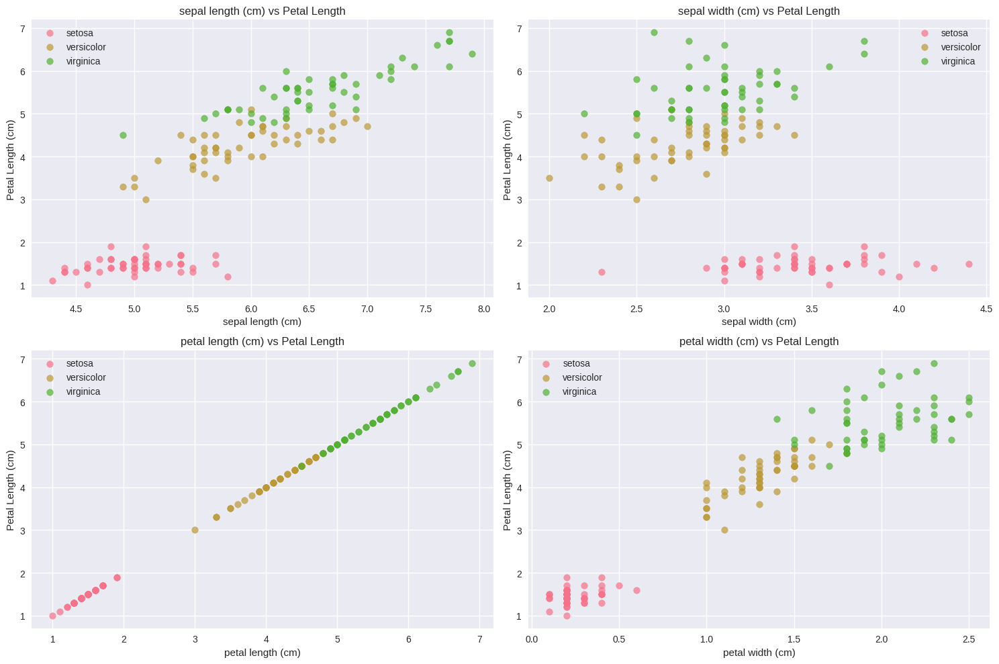

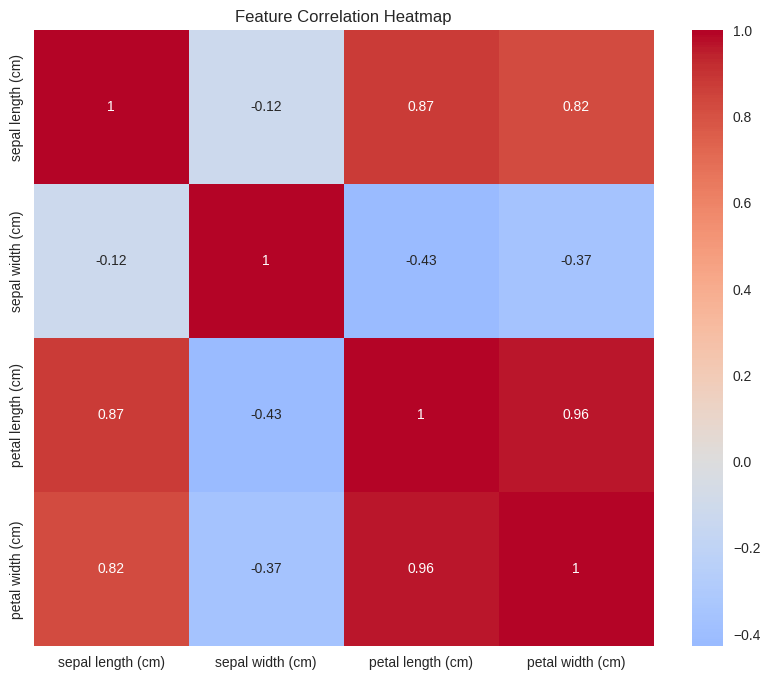

In [38]:
# 3. DATA VISUALIZATION
print("\n3. DATA VISUALIZATION")
print("-" * 40)

# Create visualizations
fig, axes = plt.subplots(2, 2, figsize=(15, 10))

# Pairplot-style scatter plots
for i, feature in enumerate(features):
    ax = axes[i//2, i%2]
    for species in df['species'].unique():
        species_data = df[df['species'] == species]
        ax.scatter(species_data[feature], species_data['petal length (cm)'],
                  label=species, alpha=0.7)
    ax.set_xlabel(feature)
    ax.set_ylabel('Petal Length (cm)')
    ax.set_title(f'{feature} vs Petal Length')
    ax.legend()

plt.tight_layout()
plt.show()

# Correlation heatmap
plt.figure(figsize=(10, 8))
correlation_matrix = X.corr()
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', center=0)
plt.title('Feature Correlation Heatmap')
plt.show()

In [39]:
# 4. SPLIT THE DATA
print("\n4. DATA SPLITTING")
print("-" * 40)

X_train, X_test, y_train, y_test = train_test_split(X_scaled, y,
                                                    test_size=0.2,
                                                    random_state=42,
                                                    stratify=y)

print(f"Training set size: {X_train.shape[0]}")
print(f"Testing set size: {X_test.shape[0]}")



4. DATA SPLITTING
----------------------------------------
Training set size: 120
Testing set size: 30


In [40]:
# 5. TRAIN MULTIPLE CLASSIFICATION MODELS
print("\n5. TRAINING MULTIPLE CLASSIFICATION MODELS")
print("-" * 40)

# Initialize models
models = {
    'Random Forest': RandomForestClassifier(random_state=42),
    'Decision Tree': DecisionTreeClassifier(random_state=42),
    'Logistic Regression': LogisticRegression(random_state=42, max_iter=1000)
}

# Train and evaluate models
model_results = {}

for name, model in models.items():
    print(f"\nTraining {name}...")

    # Train the model
    model.fit(X_train, y_train)

    # Make predictions
    y_pred = model.predict(X_test)

    # Calculate metrics
    accuracy = accuracy_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred, average='weighted')
    recall = recall_score(y_test, y_pred, average='weighted')
    f1 = f1_score(y_test, y_pred, average='weighted')

    # Store results
    model_results[name] = {
        'model': model,
        'accuracy': accuracy,
        'precision': precision,
        'recall': recall,
        'f1_score': f1,
        'predictions': y_pred
    }

    print(f"{name} Results:")
    print(f"  Accuracy: {accuracy:.4f}")
    print(f"  Precision: {precision:.4f}")
    print(f"  Recall: {recall:.4f}")
    print(f"  F1-Score: {f1:.4f}")


5. TRAINING MULTIPLE CLASSIFICATION MODELS
----------------------------------------

Training Random Forest...
Random Forest Results:
  Accuracy: 0.9333
  Precision: 0.9333
  Recall: 0.9333
  F1-Score: 0.9333

Training Decision Tree...
Decision Tree Results:
  Accuracy: 0.9333
  Precision: 0.9333
  Recall: 0.9333
  F1-Score: 0.9333

Training Logistic Regression...
Logistic Regression Results:
  Accuracy: 0.9333
  Precision: 0.9333
  Recall: 0.9333
  F1-Score: 0.9333



6. MODEL EVALUATION AND COMPARISON
----------------------------------------
Model Comparison:
                 Model  Accuracy  Precision  Recall  F1-Score
0        Random Forest    0.9333     0.9333  0.9333    0.9333
1        Decision Tree    0.9333     0.9333  0.9333    0.9333
2  Logistic Regression    0.9333     0.9333  0.9333    0.9333


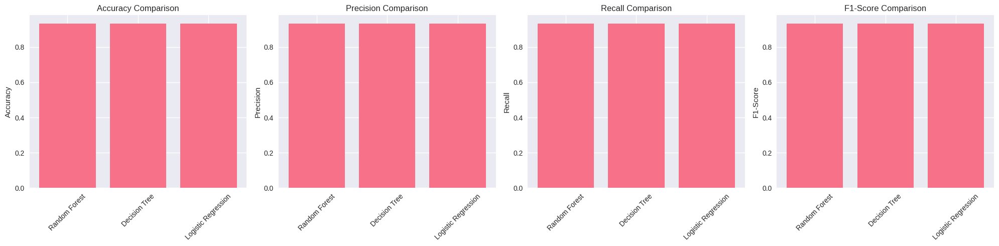


Best performing model: Random Forest


In [41]:
# 6. MODEL EVALUATION AND COMPARISON
print("\n6. MODEL EVALUATION AND COMPARISON")
print("-" * 40)

# Create comparison dataframe
comparison_df = pd.DataFrame({
    'Model': list(model_results.keys()),
    'Accuracy': [result['accuracy'] for result in model_results.values()],
    'Precision': [result['precision'] for result in model_results.values()],
    'Recall': [result['recall'] for result in model_results.values()],
    'F1-Score': [result['f1_score'] for result in model_results.values()]
})

print("Model Comparison:")
print(comparison_df.round(4))

# Visualize model comparison
fig, axes = plt.subplots(1, 4, figsize=(20, 5))
metrics = ['Accuracy', 'Precision', 'Recall', 'F1-Score']

for i, metric in enumerate(metrics):
    axes[i].bar(comparison_df['Model'], comparison_df[metric])
    axes[i].set_title(f'{metric} Comparison')
    axes[i].set_ylabel(metric)
    axes[i].tick_params(axis='x', rotation=45)

plt.tight_layout()
plt.show()

# Best performing model
best_model_name = comparison_df.loc[comparison_df['Accuracy'].idxmax(), 'Model']
print(f"\nBest performing model: {best_model_name}")



7. DETAILED EVALUATION - RANDOM FOREST
----------------------------------------
Classification Report for Random Forest:
              precision    recall  f1-score   support

      setosa       1.00      1.00      1.00        10
  versicolor       0.90      0.90      0.90        10
   virginica       0.90      0.90      0.90        10

    accuracy                           0.93        30
   macro avg       0.93      0.93      0.93        30
weighted avg       0.93      0.93      0.93        30



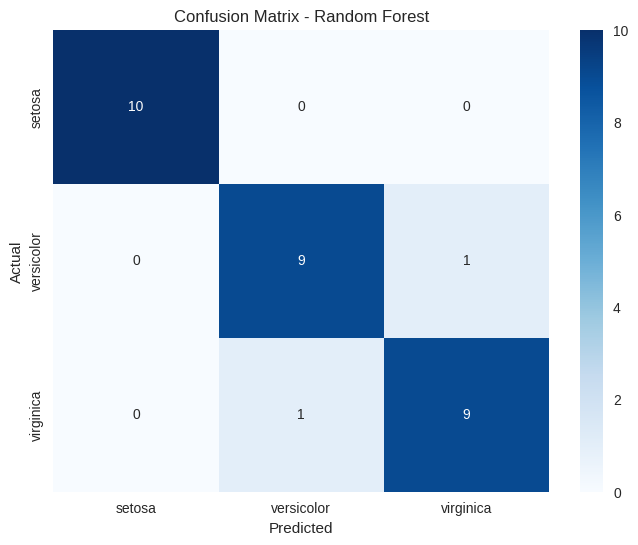

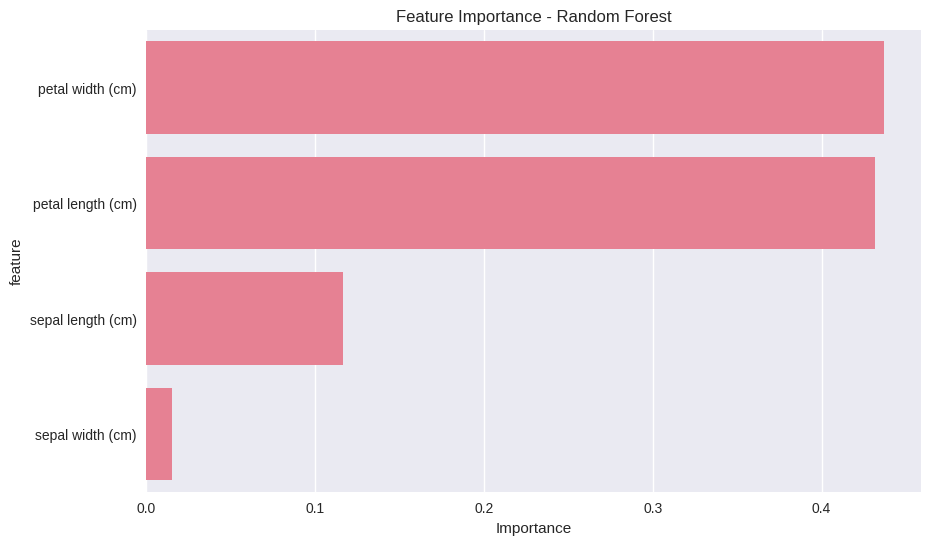

Feature Importance:
             feature  importance
3   petal width (cm)    0.437185
2  petal length (cm)    0.431466
0  sepal length (cm)    0.116349
1   sepal width (cm)    0.015000


In [42]:
# 7. DETAILED EVALUATION FOR BEST MODEL (Random Forest)
print("\n7. DETAILED EVALUATION - RANDOM FOREST")
print("-" * 40)

rf_model = model_results['Random Forest']['model']
rf_pred = model_results['Random Forest']['predictions']

# Classification Report
print("Classification Report for Random Forest:")
print(classification_report(y_test, rf_pred, target_names=le.classes_))

# Confusion Matrix
plt.figure(figsize=(8, 6))
cm = confusion_matrix(y_test, rf_pred)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=le.classes_, yticklabels=le.classes_)
plt.title('Confusion Matrix - Random Forest')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

# Feature Importance
feature_importance = pd.DataFrame({
    'feature': features,
    'importance': rf_model.feature_importances_
}).sort_values('importance', ascending=False)

plt.figure(figsize=(10, 6))
sns.barplot(data=feature_importance, x='importance', y='feature')
plt.title('Feature Importance - Random Forest')
plt.xlabel('Importance')
plt.show()

print("Feature Importance:")
print(feature_importance)

In [43]:
# 8. HYPERPARAMETER TUNING FOR RANDOM FOREST
print("\n8. HYPERPARAMETER TUNING - RANDOM FOREST")
print("-" * 40)

# Define parameter grid for Random Forest
param_grid = {
    'n_estimators': [50, 100, 200],
    'max_depth': [3, 5, 7, None],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

print("Performing Grid Search for Random Forest...")
print("Parameter grid:", param_grid)

# Perform grid search
rf_grid_search = GridSearchCV(
    RandomForestClassifier(random_state=42),
    param_grid,
    cv=5,
    scoring='accuracy',
    n_jobs=-1,
    verbose=1
)

rf_grid_search.fit(X_train, y_train)

# Best parameters and score
print(f"\nBest parameters: {rf_grid_search.best_params_}")
print(f"Best cross-validation score: {rf_grid_search.best_score_:.4f}")

# Evaluate tuned model
tuned_rf = rf_grid_search.best_estimator_
tuned_rf_pred = tuned_rf.predict(X_test)

tuned_accuracy = accuracy_score(y_test, tuned_rf_pred)
tuned_precision = precision_score(y_test, tuned_rf_pred, average='weighted')
tuned_recall = recall_score(y_test, tuned_rf_pred, average='weighted')
tuned_f1 = f1_score(y_test, tuned_rf_pred, average='weighted')

print(f"\nTuned Random Forest Results:")
print(f"  Accuracy: {tuned_accuracy:.4f}")
print(f"  Precision: {tuned_precision:.4f}")
print(f"  Recall: {tuned_recall:.4f}")
print(f"  F1-Score: {tuned_f1:.4f}")



8. HYPERPARAMETER TUNING - RANDOM FOREST
----------------------------------------
Performing Grid Search for Random Forest...
Parameter grid: {'n_estimators': [50, 100, 200], 'max_depth': [3, 5, 7, None], 'min_samples_split': [2, 5, 10], 'min_samples_leaf': [1, 2, 4]}
Fitting 5 folds for each of 108 candidates, totalling 540 fits

Best parameters: {'max_depth': 3, 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 100}
Best cross-validation score: 0.9583

Tuned Random Forest Results:
  Accuracy: 0.9667
  Precision: 0.9697
  Recall: 0.9667
  F1-Score: 0.9666


In [44]:
# 9. CROSS-VALIDATION
print("\n9. CROSS-VALIDATION")
print("-" * 40)

# Perform cross-validation for all models
cv_results = {}

for name, result in model_results.items():
    model = result['model']
    cv_scores = cross_val_score(model, X_scaled, y, cv=5, scoring='accuracy')
    cv_results[name] = {
        'mean_score': cv_scores.mean(),
        'std_score': cv_scores.std(),
        'scores': cv_scores
    }

    print(f"{name} - CV Accuracy: {cv_scores.mean():.4f} (+/- {cv_scores.std()*2:.4f})")

# Cross-validation for tuned Random Forest
tuned_cv_scores = cross_val_score(tuned_rf, X_scaled, y, cv=5, scoring='accuracy')
print(f"Tuned Random Forest - CV Accuracy: {tuned_cv_scores.mean():.4f} (+/- {tuned_cv_scores.std()*2:.4f})")



9. CROSS-VALIDATION
----------------------------------------
Random Forest - CV Accuracy: 0.9667 (+/- 0.0422)
Decision Tree - CV Accuracy: 0.9533 (+/- 0.0680)
Logistic Regression - CV Accuracy: 0.9600 (+/- 0.0777)
Tuned Random Forest - CV Accuracy: 0.9667 (+/- 0.0422)


In [45]:
# 10. FINAL SUMMARY
print("\n10. FINAL SUMMARY")
print("=" * 50)

print("OBJECTIVES COMPLETED:")
print("✓ Preprocessed the data (handled categorical variables, feature scaling)")
print("✓ Trained and tested multiple classification models:")
print("  - Decision Trees")
print("  - Logistic Regression")
print("  - Random Forest")
print("✓ Evaluated models using accuracy, precision, recall, and F1-score")
print("✓ Performed hyperparameter tuning using grid search")
print("✓ Used tools: Python, scikit-learn, pandas, matplotlib")

print(f"\nBEST MODEL: {best_model_name}")
print(f"Test Accuracy: {model_results[best_model_name]['accuracy']:.4f}")
print(f"After hyperparameter tuning: {tuned_accuracy:.4f}")

print("\nThe iris classification task has been completed successfully!")
print("All species can be classified with high accuracy using the trained models.")


10. FINAL SUMMARY
OBJECTIVES COMPLETED:
✓ Preprocessed the data (handled categorical variables, feature scaling)
✓ Trained and tested multiple classification models:
  - Decision Trees
  - Logistic Regression
  - Random Forest
✓ Evaluated models using accuracy, precision, recall, and F1-score
✓ Performed hyperparameter tuning using grid search
✓ Used tools: Python, scikit-learn, pandas, matplotlib

BEST MODEL: Random Forest
Test Accuracy: 0.9333
After hyperparameter tuning: 0.9667

The iris classification task has been completed successfully!
All species can be classified with high accuracy using the trained models.


# **Sentimen Dataset**
# Task 3: Natural Language Processing (NLP) - Sentiment Analysis

In [46]:
# 1. Install dan import library yang diperlukan
!pip install nltk textblob wordcloud --quiet

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from wordcloud import WordCloud
import nltk
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
from textblob import TextBlob

nltk.download('stopwords')
nltk.download('wordnet')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...


True

In [57]:
# 2. Load data
df = pd.read_csv("/content/3) Sentiment dataset.csv")
print("Sentiment dataset:")
print(df[["Text", "Sentiment"]].head())

Sentiment dataset:
                                                Text    Sentiment
0   Enjoying a beautiful day at the park!        ...   Positive  
1   Traffic was terrible this morning.           ...   Negative  
2   Just finished an amazing workout! 💪          ...   Positive  
3   Excited about the upcoming weekend getaway!  ...   Positive  
4   Trying out a new recipe for dinner tonight.  ...   Neutral   


In [58]:
# 3. Preprocessing: tokenisasi, hapus stopwords, dan lemmatization
def preprocess(text):
    # Konversi ke lowercase
    text = str(text).lower()
    # Tokenisasi sederhana : split by space
    tokens = text.split()
    # Hapus stopwords
    stop_words = set(stopwords.words('english'))
    tokens = [w for w in tokens if w.isalpha() and w not in stop_words]
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(w) for w in tokens]
    return ' '.join(tokens)

df['Clean_Text'] = df['Text'].apply(preprocess)

print('\nContoh hasil preprocessing:')
print(df[['Text', 'Clean_Text']].head())


Contoh hasil preprocessing:
                                                Text                Clean_Text
0   Enjoying a beautiful day at the park!        ...    enjoying beautiful day
1   Traffic was terrible this morning.           ...          traffic terrible
2   Just finished an amazing workout! 💪          ...          finished amazing
3   Excited about the upcoming weekend getaway!  ...  excited upcoming weekend
4   Trying out a new recipe for dinner tonight.  ...  trying new recipe dinner


In [59]:
# 4. Analisis Sentimen (menggunakan TextBlob)
def polarity_tb(text):
    return TextBlob(text).sentiment.polarity

def get_tb_sentiment(polarity):
    if polarity > 0.1:
        return 'Positive'
    elif polarity < -0.1:
        return 'Negative'
    else:
        return 'Neutral'

df['TB_Polarity'] = df['Clean_Text'].apply(polarity_tb)
df['TB_Sentiment'] = df['TB_Polarity'].apply(get_tb_sentiment)

# Tampilkan perbandingan label asli dan hasil analisis
print('\nPerbandingan Sentiment Data Asli & TextBlob:')
print(df[['Text','Sentiment','TB_Sentiment']].head(10))


Perbandingan Sentiment Data Asli & TextBlob:
                                                Text    Sentiment TB_Sentiment
0   Enjoying a beautiful day at the park!        ...   Positive       Positive
1   Traffic was terrible this morning.           ...   Negative       Negative
2   Just finished an amazing workout! 💪          ...   Positive       Positive
3   Excited about the upcoming weekend getaway!  ...   Positive       Positive
4   Trying out a new recipe for dinner tonight.  ...   Neutral        Positive
5   Feeling grateful for the little things in lif...   Positive       Negative
6   Rainy days call for cozy blankets and hot coc...   Positive        Neutral
7   The new movie release is a must-watch!       ...   Positive       Positive
8   Political discussions heating up on the timel...   Negative        Neutral
9   Missing summer vibes and beach days.         ...   Neutral        Negative


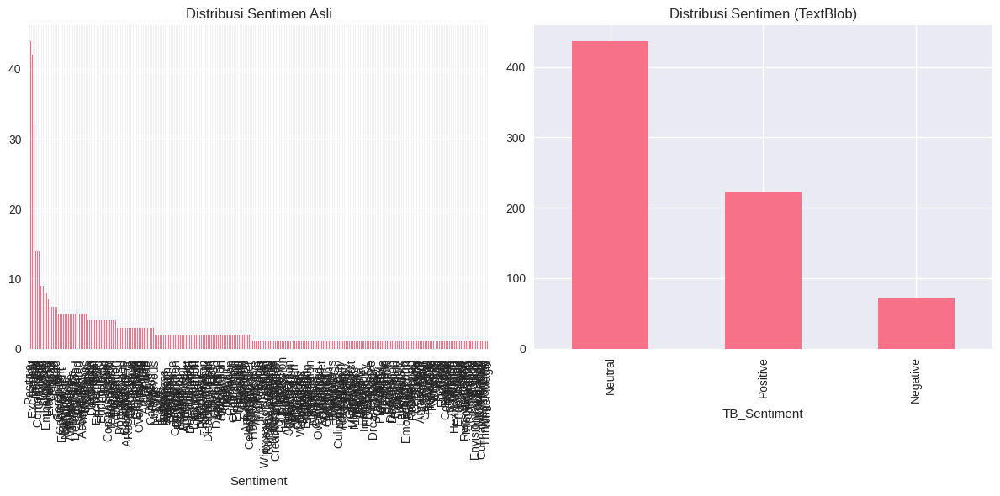

In [60]:
# 5. Visualisasi distribusi sentimen (label asli & hasil analisis)
fig, axs = plt.subplots(1, 2, figsize=(12, 6))

df['Sentiment'].value_counts().plot(kind='bar', ax=axs[0], title='Distribusi Sentimen Asli')
df['TB_Sentiment'].value_counts().plot(kind='bar', ax=axs[1], title='Distribusi Sentimen (TextBlob)')

plt.tight_layout()
plt.show()

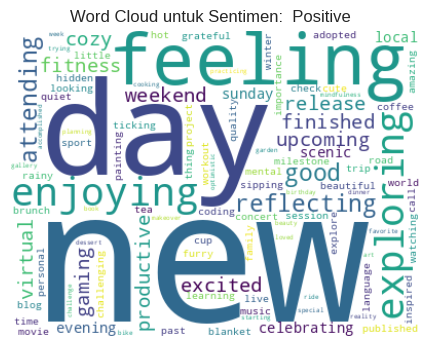

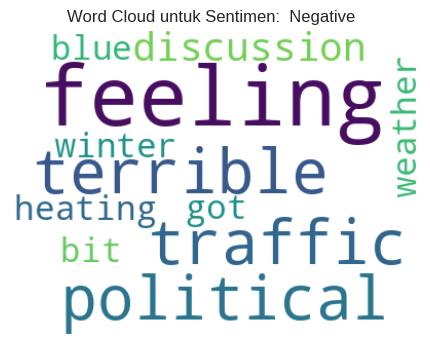

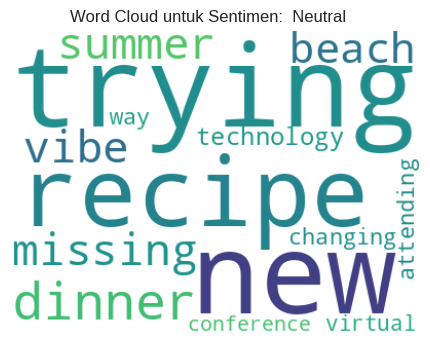

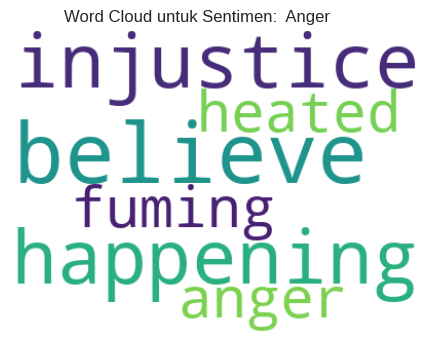

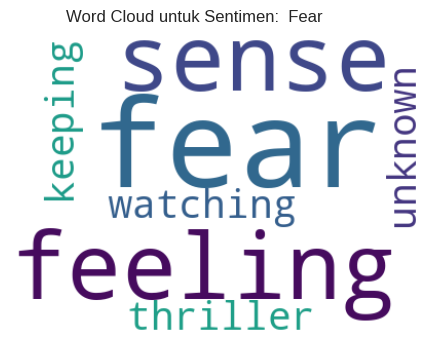

...

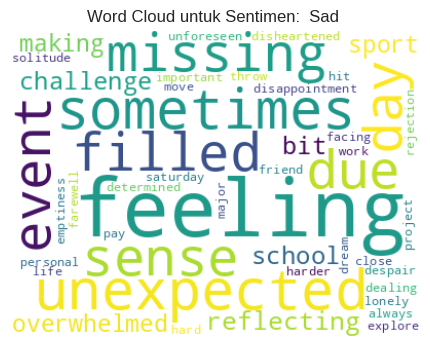

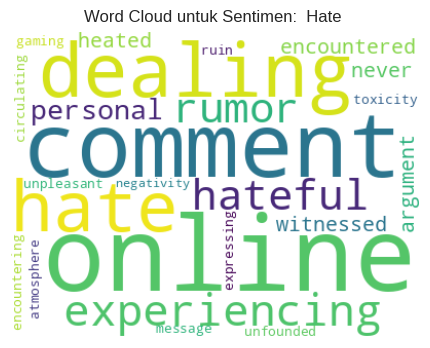

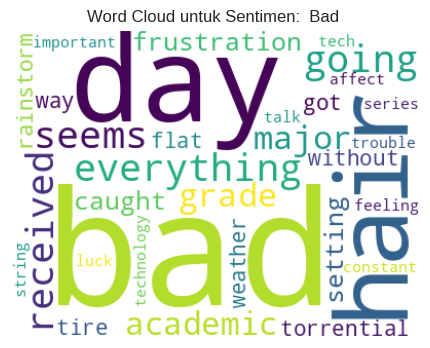

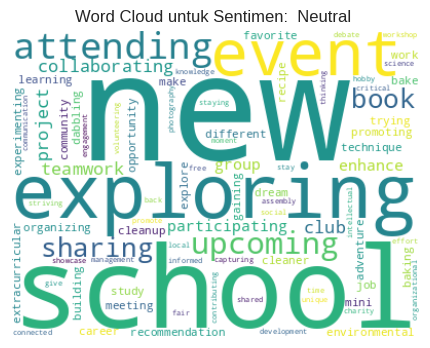

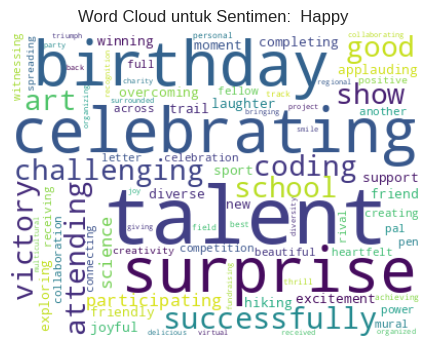

In [61]:
# 6. Word Cloud per kelas sentimen
for sentiment_label in df['Sentiment'].unique():
    text_wc = ' '.join(df[df['Sentiment']==sentiment_label]['Clean_Text'])
    if text_wc.strip() != '':
        wc = WordCloud(width=400, height=300, background_color='white').generate(text_wc)
        plt.figure(figsize=(6, 4))
        plt.imshow(wc, interpolation='bilinear')
        plt.axis('off')
        plt.title(f'Word Cloud untuk Sentimen: {sentiment_label}')
        plt.show()

In [62]:
# 7. Tools yang digunakan
print("Tools: Python, nltk, TextBlob, pandas, matplotlib, wordcloud")

Tools: Python, nltk, TextBlob, pandas, matplotlib, wordcloud


# **VERSI 2 NLP**

In [73]:
# 1. Import Libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import re # Regular expression for text cleaning

# NLTK for text preprocessing
import nltk
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
from nltk.tokenize import word_tokenize

# TextBlob for sentiment analysis
from textblob import TextBlob
# WordCloud for visualization
from wordcloud import WordCloud

# Download necessary NLTK data (run once)
try:
    nltk.data.find('corpora/stopwords')
except LookupError:
    nltk.download('stopwords')
try:
    nltk.data.find('corpora/wordnet')
except LookupError:
    nltk.download('wordnet')
try:
    nltk.data.find('tokenizers/punkt')
except LookupError:
    nltk.download('punkt')
try:
    nltk.data.find('tokenizers/punkt_tab')
except LookupError:
    nltk.download('punkt_tab')

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package punkt_tab to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt_tab.zip.


In [75]:
# 2. Load data
df = pd.read_csv("/content/3) Sentiment dataset.csv")
print("Sentiment dataset loaded successfully.")
print("Initial DataFrame head:")
print(df.head())
print("\nInitial Sentiment distribution:")
print(df['Sentiment'].value_counts())

# Rename 'Text' column to 'text' for consistency if needed
if 'Text' in df.columns:
    df.rename(columns={'Text': 'text'}, inplace=True)
# Ensure 'text' column exists
if 'text' not in df.columns:
    print("Error: 'text' column not found in the dataset. Please check your CSV file.")
    exit()

Sentiment dataset loaded successfully.
Initial DataFrame head:
   Unnamed: 0.1  Unnamed: 0  \
0             0           0   
1             1           1   
2             2           2   
3             3           3   
4             4           4   

                                                Text    Sentiment  \
0   Enjoying a beautiful day at the park!        ...   Positive     
1   Traffic was terrible this morning.           ...   Negative     
2   Just finished an amazing workout! 💪          ...   Positive     
3   Excited about the upcoming weekend getaway!  ...   Positive     
4   Trying out a new recipe for dinner tonight.  ...   Neutral      

             Timestamp            User     Platform  \
0  2023-01-15 12:30:00   User123          Twitter     
1  2023-01-15 08:45:00   CommuterX        Twitter     
2  2023-01-15 15:45:00   FitnessFan      Instagram    
3  2023-01-15 18:20:00   AdventureX       Facebook    
4  2023-01-15 19:55:00   ChefCook        Instagram    

    

In [76]:
# 3. Text Preprocessing
print("\nStarting text preprocessing...")
# Initialize lemmatizer and stopwords
lemmatizer = WordNetLemmatizer()
stop_words = set(stopwords.words('english'))

def preprocess_text(text):
    # Convert to lowercase
    text = str(text).lower()
    # Remove special characters, numbers, and punctuation
    text = re.sub(r'[^a-zA-Z\s]', '', text)
    # Tokenization
    tokens = word_tokenize(text)
    # Remove stopwords and perform lemmatization
    processed_tokens = [
        lemmatizer.lemmatize(word) for word in tokens if word not in stop_words
    ]
    # Join tokens back into a string
    return ' '.join(processed_tokens)

# Download punkt tokenizer if not already downloaded
try:
    nltk.data.find('tokenizers/punkt')
except LookupError:
    nltk.download('punkt')

df['cleaned_text'] = df['text'].apply(preprocess_text)
print("Text preprocessing complete. Cleaned text example:")
print(df['cleaned_text'].head())


Starting text preprocessing...
Text preprocessing complete. Cleaned text example:
0         enjoying beautiful day park
1            traffic terrible morning
2            finished amazing workout
3    excited upcoming weekend getaway
4    trying new recipe dinner tonight
Name: cleaned_text, dtype: object


In [78]:
# 4. Sentiment Analysis using TextBlob
print("\nPerforming sentiment analysis with TextBlob...")
def get_textblob_sentiment(text):
    analysis = TextBlob(text)
    # Classify sentiment based on polarity
    if analysis.polarity > 0:
        return 'Positive'
    elif analysis.polarity < 0:
        return 'Negative'
    else:
        return 'Neutral'

# Apply sentiment analysis to the cleaned text
df['textblob_sentiment'] = df['cleaned_text'].apply(get_textblob_sentiment)
print("Sentiment analysis complete. TextBlob sentiment example:")
print(df[['text', 'textblob_sentiment']].head())


Performing sentiment analysis with TextBlob...
Sentiment analysis complete. TextBlob sentiment example:
                                                text textblob_sentiment
0   Enjoying a beautiful day at the park!        ...           Positive
1   Traffic was terrible this morning.           ...           Negative
2   Just finished an amazing workout! 💪          ...           Positive
3   Excited about the upcoming weekend getaway!  ...           Positive
4   Trying out a new recipe for dinner tonight.  ...           Positive



Visualizing sentiment distribution...


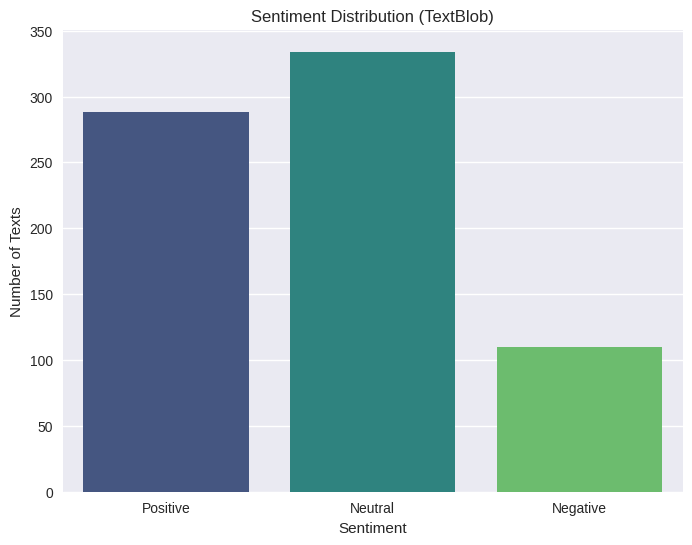


Original Sentiment Distribution:
Sentiment
Positive               44
Joy                    42
Excitement             32
Happy                  14
Neutral                14
                       ..
Vibrancy                1
Culinary Adventure      1
Mesmerizing             1
Thrilling Journey       1
Winter Magic            1
Name: count, Length: 279, dtype: int64


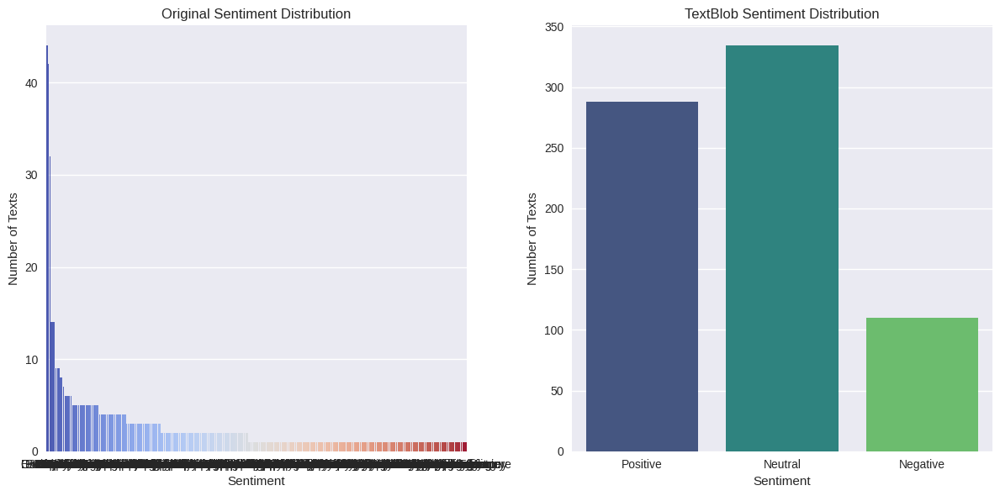


Cross-tabulation of Original vs. TextBlob Sentiment:
textblob_sentiment  Negative  Neutral  Positive
Sentiment                                      
Acceptance                 1        2         0
Acceptance                 1        3         1
Accomplishment             0        0         3
Admiration                 0        0         1
Admiration                 0        1         1
...                      ...      ...       ...
Wonder                     0        1         0
Wonder                     0        1         0
Wonderment                 0        1         0
Yearning                   1        1         0
Zest                       0        0         2

[279 rows x 3 columns]


In [80]:
# 5. Visualize Sentiment Distribution
print("\nVisualizing sentiment distribution...")
plt.figure(figsize=(8, 6))
sns.countplot(x='textblob_sentiment', data=df, palette='viridis', order=['Positive', 'Neutral', 'Negative'])
plt.title('Sentiment Distribution (TextBlob)')
plt.xlabel('Sentiment')
plt.ylabel('Number of Texts')
plt.show()

# Compare with original sentiment if available
if 'Sentiment' in df.columns:
    print("\nOriginal Sentiment Distribution:")
    print(df['Sentiment'].value_counts())

    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    sns.countplot(x='Sentiment', data=df, palette='coolwarm', order=df['Sentiment'].value_counts().index)
    plt.title('Original Sentiment Distribution')
    plt.xlabel('Sentiment')
    plt.ylabel('Number of Texts')

    plt.subplot(1, 2, 2)
    sns.countplot(x='textblob_sentiment', data=df, palette='viridis', order=['Positive', 'Neutral', 'Negative'])
    plt.title('TextBlob Sentiment Distribution')
    plt.xlabel('Sentiment')
    plt.ylabel('Number of Texts')
    plt.tight_layout()
    plt.show()

     # Optional: Cross-tabulation to see agreement
    print("\nCross-tabulation of Original vs. TextBlob Sentiment:")
    print(pd.crosstab(df['Sentiment'], df['textblob_sentiment']))





Generating Word Clouds for each sentiment category...


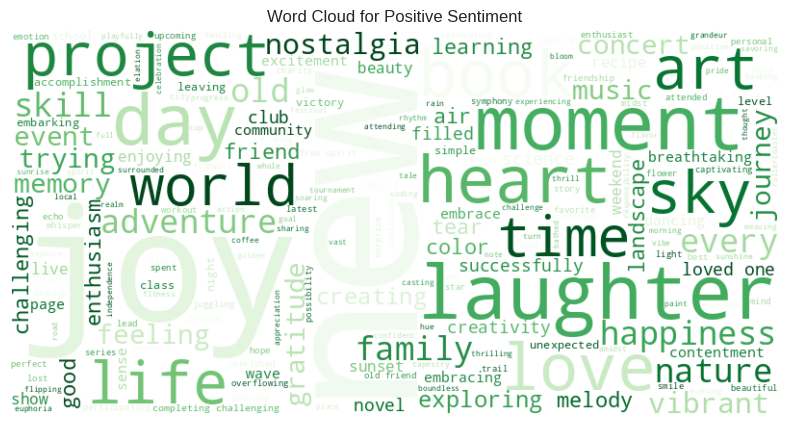

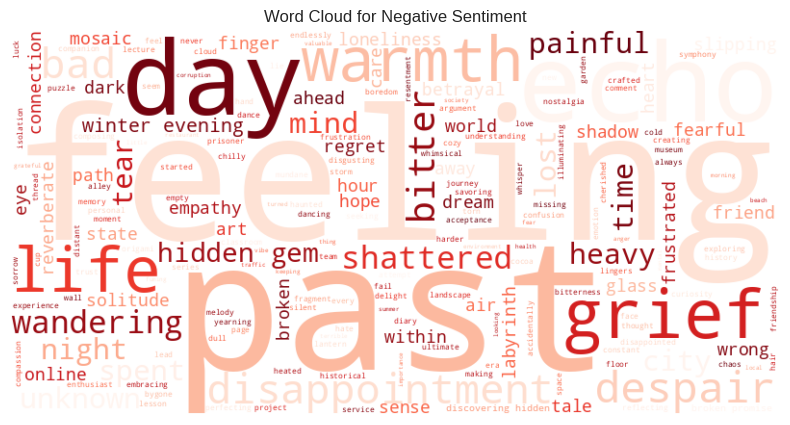

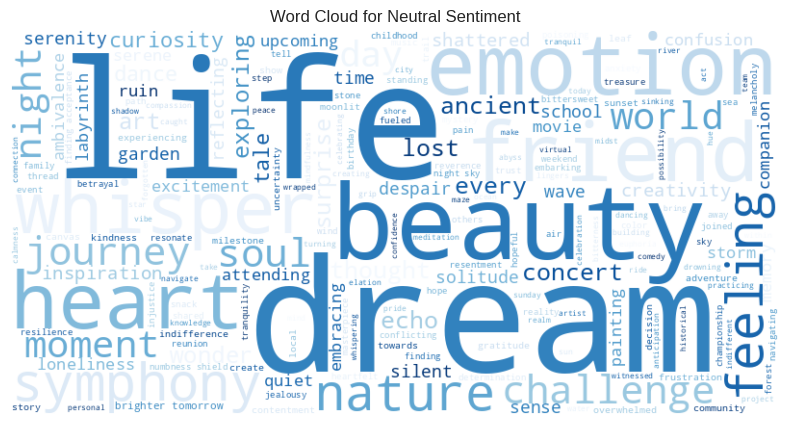


Sentiment analysis and visualization complete.


In [81]:
# 6. Visualize Word Frequencies using Word Clouds
print("\nGenerating Word Clouds for each sentiment category...")

# Combine all cleaned text for each sentiment category
positive_text = " ".join(df[df['textblob_sentiment'] == 'Positive']['cleaned_text'])
negative_text = " ".join(df[df['textblob_sentiment'] == 'Negative']['cleaned_text'])
neutral_text = " ".join(df[df['textblob_sentiment'] == 'Neutral']['cleaned_text'])

# Generate Word Clouds
def generate_wordcloud(text, title, color_map='viridis'):
    wordcloud = WordCloud(width=800, height=400, background_color='white', colormap=color_map).generate(text)
    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.title(title)
    plt.axis('off')
    plt.show()

if positive_text:
    generate_wordcloud(positive_text, 'Word Cloud for Positive Sentiment', 'Greens')
else:
    print("No positive text found for word cloud.")

if negative_text:
    generate_wordcloud(negative_text, 'Word Cloud for Negative Sentiment', 'Reds')
else:
    print("No negative text found for word cloud.")

if neutral_text:
    generate_wordcloud(neutral_text, 'Word Cloud for Neutral Sentiment', 'Blues')
else:
    print("No neutral text found for word cloud.")

print("\nSentiment analysis and visualization complete.")